# Apartment Rent Dataset Classification

## Objective
Implement a data mining project using the Python machine learning library Spark MLlib to predict rental prices (`price`).  
Only Spark MLlib can be used for machine learning tasks, but non-ML libraries are allowed for other purposes.


## Data Source
[Kaggle: Apartment Rent Data](https://www.kaggle.com/datasets/shashanks1202/apartment-rent-data)
This dataset comprises detailed information on apartment rentals

This dataset comprises detailed information on apartment rentals:

- **Identifiers & Location:**  
  - Unique identifiers (`id`)
  - Geographic details (`address`, `cityname`, `state`, `latitude`, `longitude`)
  - Source of the classified listing (`source`)

- **Property Details:**  
  - Category (`category`)
  - Title (`title`)
  - Description (`body`)
  - Amenities (`amenities`)
  - Number of bathrooms (`bathrooms`)
  - Number of bedrooms (`bedrooms`)
  - Size of the apartment (`square_feet`)

- **Pricing Information:**  
  - Rental price (`price`)
  - Displayed price (`price_display`)
  - Price type (`price_type`)
  - Fee (`fee`)

- **Additional Features:**  
  - Photo availability (`has_photo`)
  - Pets allowed (`pets_allowed`)
  - Currency (`currency`)
  - Time of listing creation (`time`)

## Project Phases
1. **Discover and visualize the data**  
2. **Prepare the data for machine learning algorithms**  
3. **Select and train models**  
4. **Fine-tune the model**  
5. **Evaluate the outcomes**  

> **Note:**  
> You must repeat phases 3, 4, and 5 for at least three different models.

In [1]:
#!/usr/bin/env python3
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
pd.set_option('display.float_format', lambda x: f'{x:,.2f}')

# Load dataset
DATA_PATH = "./data/apartments_for_rent_classified_100K.csv"
df = pd.read_csv(DATA_PATH, delimiter=';', encoding='ISO-8859-1')
df.shape

/tmp/ipykernel_110/1453841023.py:11: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(DATA_PATH, delimiter=';', encoding='ISO-8859-1')


(99492, 22)

# (a) Discover and Visualize the Data  

## Dataset Structure Analysis

**Objective:** Understand data characteristics to inform preprocessing strategies.

### Key Analysis Areas
- **Data types and structure** - Feature characteristics and distributions
- **Missing data patterns** - Identify incomplete records and percentages  
- **Feature cardinality** - Assess uniqueness and dimensionality issues
- **Correlation analysis** - Examine relationships between numerical variables
- **Data quality issues** - Detect duplicates, outliers, and inconsistencies

In [2]:
# Understand structure and type of the data
# ------------------------------------------------------------------
summary = []
for col in df.columns:
    value_counts = df[col].value_counts().head(10)
    top_values = [str(x)[:50] for x in value_counts.index]  # Truncate long values
    summary.append({
        "Column": col,
        "Data Type": str(df[col].dtype),
        "Unique Values": df[col].nunique(),
        "Top 10 frequent Values (desc)": " | ".join(top_values)
    })

summary_df = pd.DataFrame(summary)
summary_df

,Column,Data Type,Unique Values,Top 10 frequent Values (desc)
0,id,int64,99408,5197858885 | 5197859052 | 5197859695 | 5197860...
1,category,object,7,housing/rent/apartment | housing/rent/commerci...
2,title,object,58503,Apartment in great location | Apartment in pri...
3,body,object,94503,"When searching for a pet-friendly One-, Two- a..."
4,amenities,object,9827,"Parking | Parking,Storage | Gym,Pool | Pool | ..."
5,bathrooms,float64,16,1.0 | 2.0 | 1.5 | 2.5 | 3.0 | 3.5 | 4.0 | 4.5 ...
6,bedrooms,float64,10,2.0 | 1.0 | 3.0 | 4.0 | 0.0 | 5.0 | 6.0 | 7.0 ...
7,currency,object,1,USD
8,fee,object,2,No | Yes
9,has_photo,object,3,Yes | Thumbnail | No


In [3]:
# Missing data %
# ------------------------------------------------------------------
pd.set_option('display.float_format', lambda x: f'{x:,.4f}')
missing_values = (df.isnull().sum())/ (df.shape[0]) * 100
missing_values.loc[missing_values > 0].sort_values(ascending=False)

address         92.0164
pets_allowed    60.7325
amenities       16.1259
state            0.3035
cityname         0.3035
bedrooms         0.1246
bathrooms        0.0633
latitude         0.0251
longitude        0.0251
price_display    0.0010
price            0.0010
dtype: float64

In [4]:
# Determine cardinality of features (i.e the effective uniqueness)
# ------------------------------------------------------------------
categorical_cols = [col for col in df.columns if col not in ['id','longitude','latitude','price','time','title','body','address','square_feet','price_display']]
max_len = max(len(col) for col in categorical_cols)
for col in categorical_cols:
    print(f"{col.ljust(max_len)} :{str(df[col].dtype).ljust(10)} : {str(df[col].nunique()).rjust(10)} unique values")

category     :object     :          7 unique values
amenities    :object     :       9827 unique values
bathrooms    :float64    :         16 unique values
bedrooms     :float64    :         10 unique values
currency     :object     :          1 unique values
fee          :object     :          2 unique values
has_photo    :object     :          3 unique values
pets_allowed :object     :          4 unique values
price_type   :object     :          3 unique values
cityname     :object     :       2979 unique values
state        :object     :         51 unique values
source       :object     :         25 unique values


In [5]:
# Check if identifier has duplicates
# ------------------------------------------------------------------
print(f"id has duplicates: {df['id'].duplicated().any()}")

id has duplicates: True


Text(0.5, 1.0, 'Correlation Matrix')

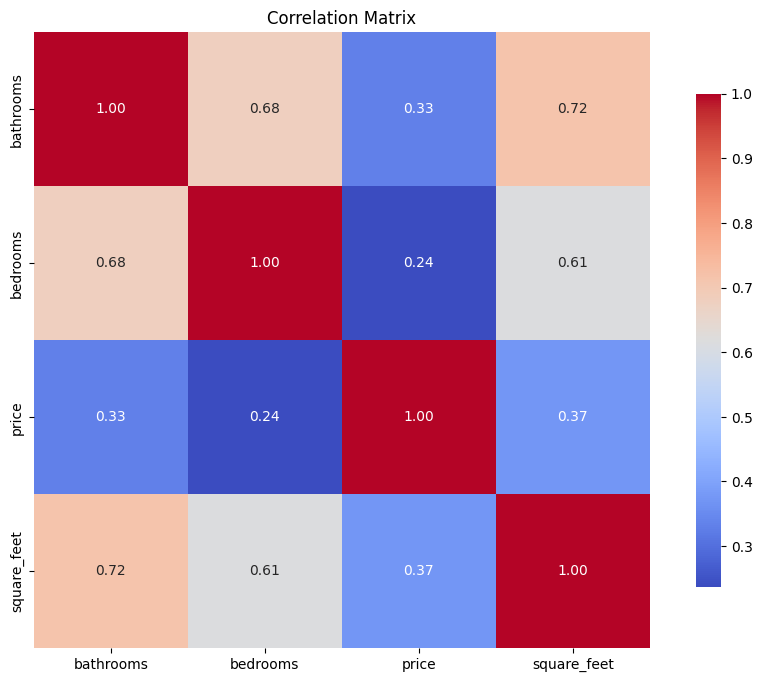

In [6]:
# Correlation analysis
# ------------------------------------------------------------------
correlation_matrix = df[['bathrooms', 'bedrooms', 'price', 'square_feet']].corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True, cbar_kws={"shrink": .8})
plt.title('Correlation Matrix')

## (a)(2) Results of Analysis of the Structure and Content of Each Column

### Missing Values Analysis
There are missing values in the dataset, most notably for `address` where **92% of the values are missing**.

### Cardinality Assessment
We define **high cardinality** as a feature having more than 20 unique values. Looking at categorical features, we encounter significant cardinality issues:  

| Feature | Unique Values | Category | Issue Level |
|---------|---------------|----------|-------------|
| `amenities` | 9,827 | Very High | ⚠️ Critical |
| `cityname` | 2,979 | Very High | ⚠️ Critical |
| `source` | ~50+ | High | ⚠️ Moderate |
| `state` | ~50 | High | ⚠️ Moderate |

**Impact**: High cardinality features can lead to:
- Sparse feature matrices after one-hot encoding  
- Overfitting due to too many dimensions  
- Poor model generalization  

### Duplicate Values Detection
Duplicate values found in:  
- **Identifiers**: `id` field has duplicates  
- **Free text fields**: Both `title` and `body` contain duplicates  

---

## Analyzing The Distribution Of Values in The Dataset

### Analysis Methods
- **Bar graphs** of categorical features  
- **Box plots** of numeric features    
- **Histograms** of numeric features  

### Objectives
- 🎯 **Identify outliers** in numerical data  
- 📊 **Examine statistics** of numerical features (ranges, min/max values)  
- 📈 **Assess data distribution** - determine if values are well-spread or skewed  

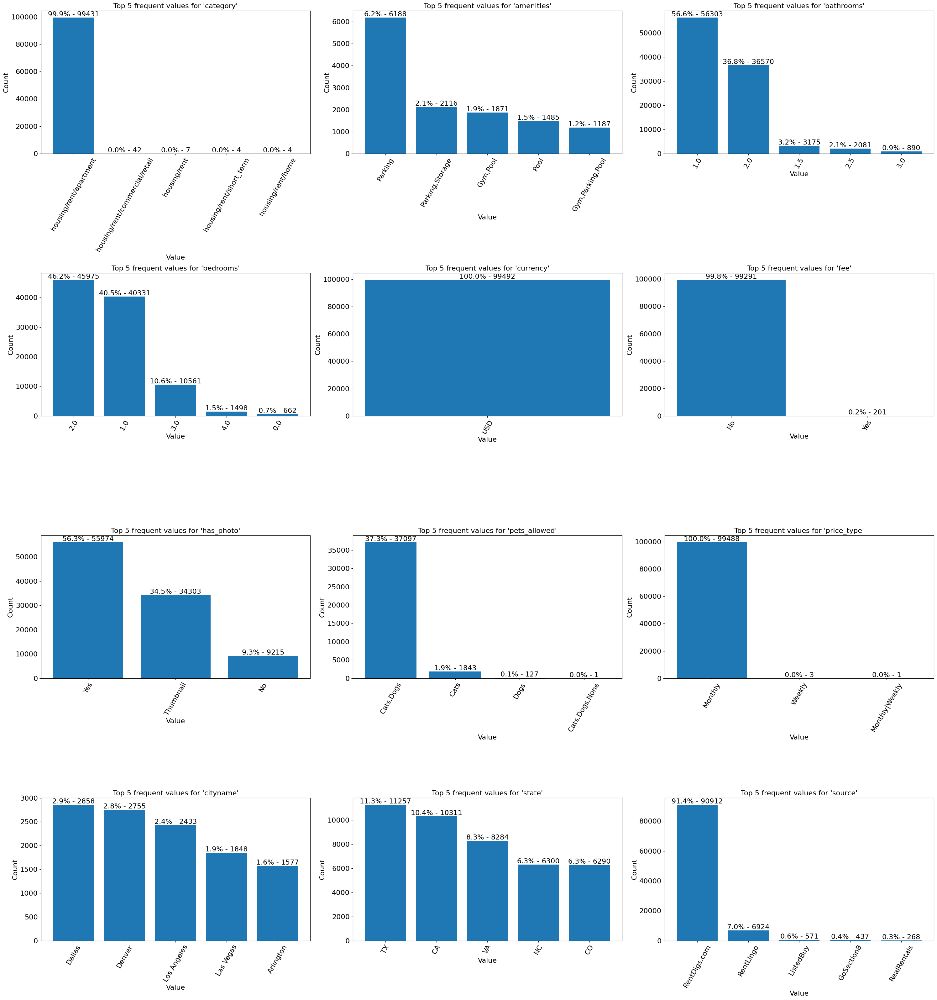

In [7]:
"""
Visualize the distribution of features in the dataset.
Also shows the percentage of the dataset that each value represents.
Only the top 5 most frequent values for each feature are plotted.
**This ignores null values, there are features where most of the values are null
"""

import math
# The following columns are ignored
columns_to_plot = [col for col in df.columns if col not in [
    'id', # Unique identifier, not useful for plotting
    'body', 'title', 'address', # Free text field
    'latitude', 'longitude', # GPS exact values, not useful for plotting
    'time','square_feet','price','price_display' # Numeric fields, not categorical
    ]]
num_cols = len(columns_to_plot)
cols_per_row = 3  # Fewer columns per row for more space
num_rows = math.ceil(num_cols / cols_per_row)

fig, axes = plt.subplots(num_rows, cols_per_row, figsize=(cols_per_row*10, num_rows*8))
axes = axes.flatten()

for i, col in enumerate(columns_to_plot):
    value_counts = df[col].value_counts().head(5)
    total = len(df)
    unique_count = df[col].nunique()
    # Use a colormap for more colorful bars
    bars = axes[i].bar(value_counts.index.astype(str), value_counts.values)
    axes[i].set_title(f"Top 5 frequent values for '{col}'", fontsize=16)
    axes[i].set_xlabel("Value",fontsize=16)
    axes[i].set_ylabel("Count", fontsize=16)
    axes[i].tick_params(axis='x', rotation=60, labelsize=16)
    axes[i].tick_params(axis='y', labelsize=16)
    for bar, count in zip(bars, value_counts.values):
        percent = 100 * count / total
        axes[i].text(bar.get_x() + bar.get_width()/2, bar.get_height(), f"{percent:.1f}% - {count}",
                     ha='center', va='bottom', fontsize=16, color='black')

# Hide any unused subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()

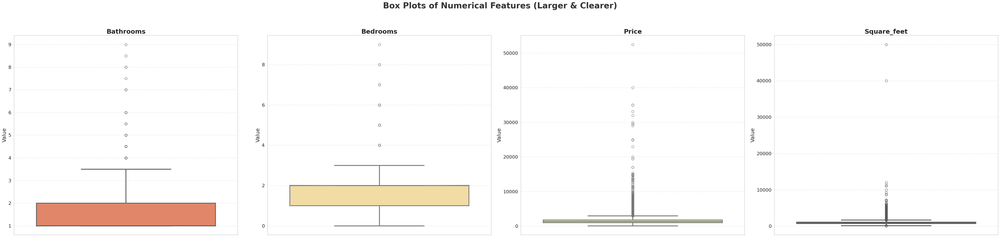

In [8]:
# Identifying outliers with larger, clearer boxplots

import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

float_cols = ["bathrooms", "bedrooms", "price", "square_feet"]

sns.set(style="whitegrid", font_scale=1.5)
num_cols = len(float_cols)
fig, axes = plt.subplots(1, num_cols, figsize=(12*num_cols, 12), sharey=False)

for i, col in enumerate(float_cols):
    sns.boxplot(
        y=df[col],
        ax=axes[i],
        color=sns.color_palette("Spectral", num_cols)[i],
        notch=True,
        linewidth=3,
        fliersize=8,
        boxprops=dict(alpha=0.9)
    )
    axes[i].set_title(f"{col.capitalize()}", fontsize=22, weight='bold')
    axes[i].set_xlabel("")
    axes[i].set_ylabel("Value", fontsize=18)
    axes[i].grid(axis='y', linestyle='--', alpha=0.5)
    axes[i].tick_params(axis='y', labelsize=16)
    axes[i].tick_params(axis='x', labelsize=16)

plt.suptitle("Box Plots of Numerical Features (Larger & Clearer)", fontsize=28, weight='bold', color='#333333')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

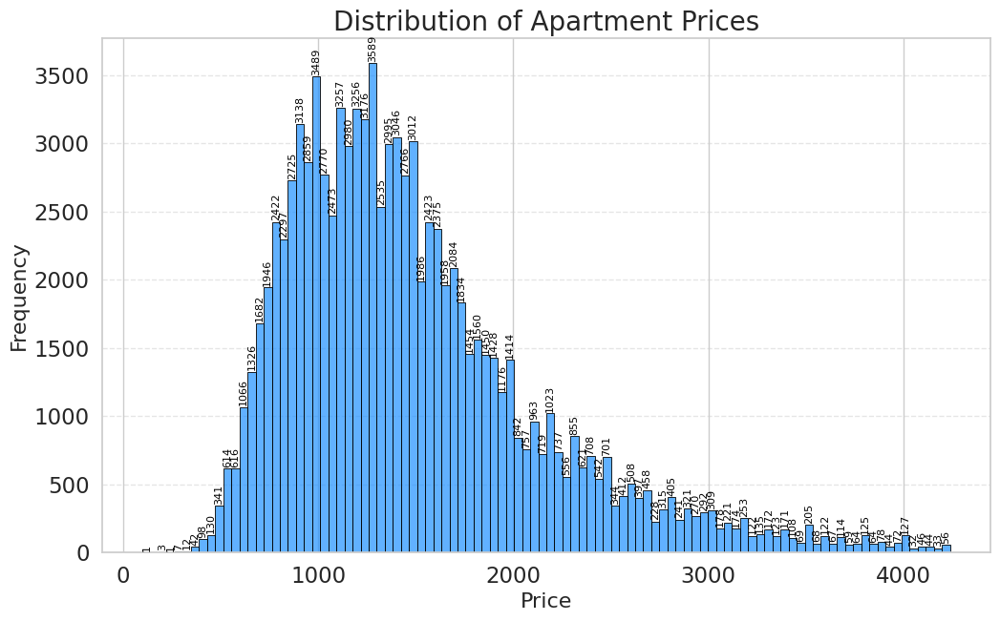

Price histogram: 98482 rows, 3298 unique prices
--------------------------------------------------
Price Statistics
count   99,491.00
mean     1,527.06
std        904.25
min        100.00
25%      1,013.00
50%      1,350.00
75%      1,795.00
max     52,500.00
Name: price, dtype: float64


In [9]:
# Histogram for price excluding outliers
pd.set_option('display.float_format', lambda x: f'{x:,.2f}')
# Exclude outliers (5 std from mean)
mean_price = df['price'].mean()
std_price = df['price'].std()
lower_bound = mean_price - 3 * std_price
upper_bound = mean_price + 3 * std_price
price_histogram = df[(df['price'] >= lower_bound) & (df['price'] <= upper_bound)].copy(deep=True)


plt.figure(figsize=(12, 7))
ax = sns.histplot(
    price_histogram['price'].dropna(),
    bins=100,
    color='dodgerblue',
    edgecolor='black',
    alpha=0.7
)
ax.set_title('Distribution of Apartment Prices', fontsize=20)
ax.set_xlabel('Price', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.grid(axis='y', linestyle='--', alpha=0.5)

# Annotate each bin with its count
for patch in ax.patches:
    if patch.get_height() > 0:
        ax.annotate(
            f'{int(patch.get_height())}',
            (patch.get_x() + patch.get_width() / 2, patch.get_height() +10),
            ha='center', va='bottom', fontsize=8, color='black', rotation=90
        )

plt.show()

print(f"Price histogram: {len(price_histogram)} rows, {price_histogram['price'].nunique()} unique prices")
print('-' * 50)
print(f"Price Statistics")
print(df['price'].describe())

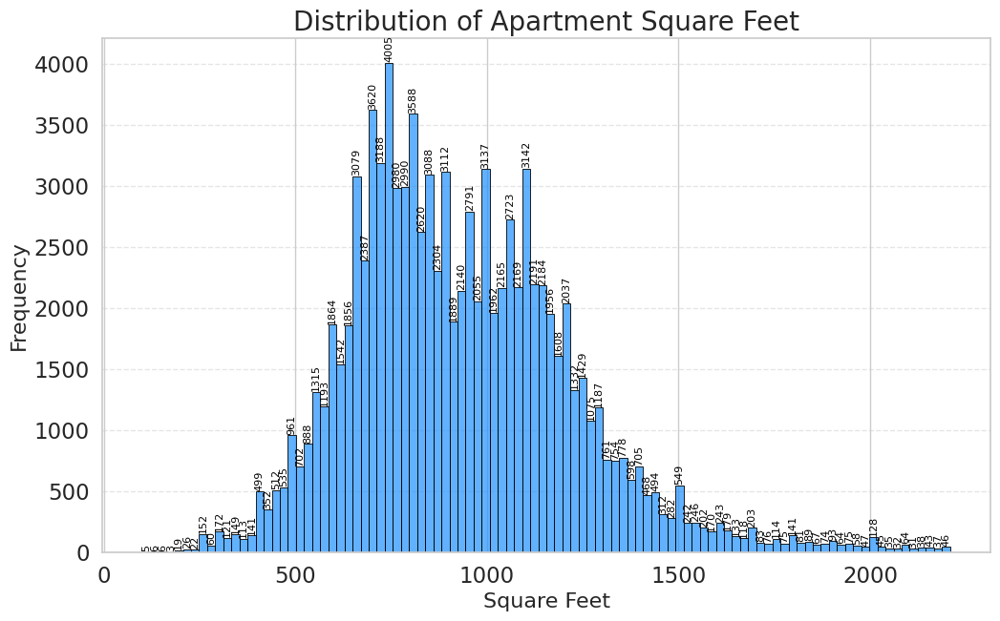

Square feet histogram: 98420 rows, 1875 unique square feet values
--------------------------------------------------
Square Feet Statistics
count   99,492.00
mean       956.43
std        417.57
min        101.00
25%        729.00
50%        900.00
75%      1,115.00
max     50,000.00
Name: square_feet, dtype: float64


In [10]:
# Histogram for square feet excluding outliers

# Exclude outliers (3 std from mean)
mean_sqft = df['square_feet'].mean()
std_sqft = df['square_feet'].std()
lower_bound = mean_sqft - 3 * std_sqft
upper_bound = mean_sqft + 3 * std_sqft
square_feet_histogram = df[(df['square_feet'] >= lower_bound) & (df['square_feet'] <= upper_bound)].copy(deep=True)

# graph
plt.figure(figsize=(12, 7))
ax = sns.histplot(
    square_feet_histogram['square_feet'].dropna(),
    bins=100,
    color='dodgerblue',
    edgecolor='black',
    alpha=0.7
)
ax.set_title('Distribution of Apartment Square Feet', fontsize=20)
ax.set_xlabel('Square Feet', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.grid(axis='y', linestyle='--', alpha=0.5)

# Annotate each bin with its count, with more vertical separation
for patch in ax.patches:
    if patch.get_height() > 0:
        ax.annotate(
            f'{int(patch.get_height())}',
            (patch.get_x() + patch.get_width() / 2, patch.get_height() + 5),
            ha='center', va='bottom', fontsize=8, color='black', rotation=90
        )

plt.show()

# stats
print(f"Square feet histogram: {len(square_feet_histogram)} rows, {square_feet_histogram['square_feet'].nunique()} unique square feet values")
print('-' * 50)
print(f"Square Feet Statistics")
print(df['square_feet'].describe())

## Summary of Data Quality Issues and Preprocessing Concerns

### 🔍 **Duplicate Data Issues**
- **`id`** - Contains duplicate identifiers that need investigation  
- **`title`, `body`** - Free text fields with duplicates; need to determine if these are legitimate listings or cross-platform duplicates from different `source`   sites

### ⚖️ **Highly Skewed Features (Low Information Value)**
Features dominated by a single value (~90%+ of data):  
- **`category`** - 99.4% are "housing/rent/apartment"  
- **`currency`** - 100% are USD  
- **`fee`** - 99.8% are "No"  
- **`price_type`** - 99.9% are "Monthly"   
- **`source`** - 91.4% are from "RentDigs.com"  

*Impact: These features provide minimal predictive power due to lack of variance*

### 🎯 **Extreme Outliers**
Numerical features with extreme values requiring treatment:  
- **`price`** - Rental prices with unrealistic extremes  
- **`square_feet`** - Property sizes with outliers  
- **`bedrooms`** - Bedroom counts with extreme values  
- **`bathrooms`** - Bathroom counts with extreme values  

### 🗂️ **High Cardinality Features**
Features requiring dimensionality reduction:  
- **`amenities`** - 9,827 unique values (combinatorial explosion)  
- **`cityname`** - 2,979 unique cities  

### ❌ **Missing Data**
Features with significant missing values:  
- **`address`** - 92% missing (can be safely dropped)  
- **`pets_allowed`** - 60.7% missing  
- **`amenities`** - 16% missing   

### 🔧 **Processing Requirements**
- **`price_display`** - Redundant formatting of `price`, safe to drop  
- **`currency`** - All USD, safe to drop  
- **`title`, `body`** - Text features need processing or exclusion  
- **`latitude`, `longitude`** - Raw coordinates require transformation for usefulness  
- **Categorical features** - Require multi-value binarization (one-hot encoding)  

### 📈 **Rare Categories**  
- **`price_type`**, **`pets_allowed`** - Contain single-occurrence values that may cause issues  


## Key Dataset Insights
**Exploring geographic patterns, pricing trends, and market distribution across the US apartment rental market.**

In [11]:
# Imports for displaying graph images
import plotly.io as pio
from IPython.display import Image

In [12]:
# Geographical map
# Prepare data for mapping
geo_df = df.copy(deep=True)
geo_df = geo_df.dropna(subset=['latitude', 'longitude', 'price'])
geo_df["address"] = geo_df["address"].fillna('Not available')


fig = px.scatter_mapbox(
    geo_df,
    lat="latitude",
    lon="longitude",
    color="price",
    size="price",
    hover_name="title",
    hover_data=["address", "category", "source","state","cityname"],
    mapbox_style="carto-positron",
    zoom=3,
    color_continuous_scale=px.colors.sequential.Plasma,
    title="Geological Map of Apartment Prices"
)

fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
fig.show()

/tmp/ipykernel_110/2639109610.py:8: DeprecationWarning: *scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/
  fig = px.scatter_mapbox(


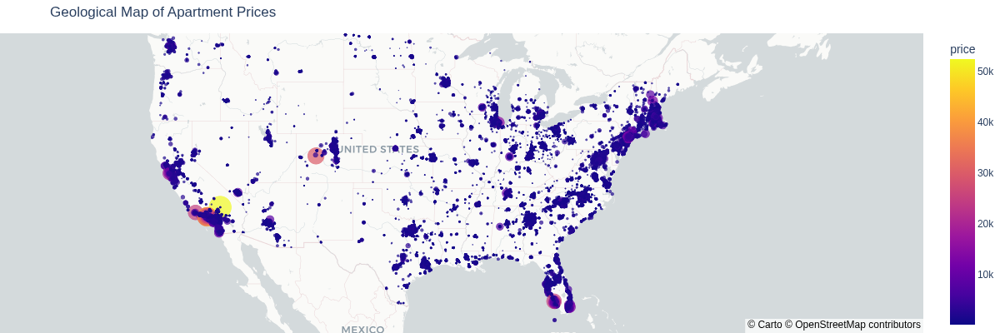

In [13]:
# Save the figure as an image & Display in report
# Note: This is done so the plotly graph is displayed in the exported pdf
# ----------------------------------------------------------------------
pio.write_image(fig,"./images/geo_map_apartment_prices.png",width=1200, height=400)
Image("./images/geo_map_apartment_prices.png")

In [14]:
state_names = {
    'AL': 'Alabama', 'AK': 'Alaska', 'AZ': 'Arizona', 'AR': 'Arkansas', 'CA': 'California',
    'CO': 'Colorado', 'CT': 'Connecticut', 'DE': 'Delaware', 'FL': 'Florida', 'GA': 'Georgia',
    'HI': 'Hawaii', 'ID': 'Idaho', 'IL': 'Illinois', 'IN': 'Indiana', 'IA': 'Iowa',
    'KS': 'Kansas', 'KY': 'Kentucky', 'LA': 'Louisiana', 'ME': 'Maine', 'MD': 'Maryland',
    'MA': 'Massachusetts', 'MI': 'Michigan', 'MN': 'Minnesota', 'MS': 'Mississippi', 'MO': 'Missouri',
    'MT': 'Montana', 'NE': 'Nebraska', 'NV': 'Nevada', 'NH': 'New Hampshire', 'NJ': 'New Jersey',
    'NM': 'New Mexico', 'NY': 'New York', 'NC': 'North Carolina', 'ND': 'North Dakota', 'OH': 'Ohio',
    'OK': 'Oklahoma', 'OR': 'Oregon', 'PA': 'Pennsylvania', 'RI': 'Rhode Island', 'SC': 'South Carolina',
    'SD': 'South Dakota', 'TN': 'Tennessee', 'TX': 'Texas', 'UT': 'Utah', 'VT': 'Vermont',
    'VA': 'Virginia', 'WA': 'Washington', 'WV': 'West Virginia', 'WI': 'Wisconsin', 'WY': 'Wyoming'
}

# Calculate median price per state
state_prices = df.groupby('state')['price'].median().sort_values()

# Get top 5 least and top 5 most expensive states
least_expensive = state_prices.head(5)
most_expensive = state_prices.tail(5)

# Combine for plotting
contrast_states = pd.concat([least_expensive, most_expensive]).reset_index()
contrast_states['State Name'] = contrast_states['state'].map(state_names)
contrast_states['Group'] = ['Least Expensive']*5 + ['Most Expensive']*5

fig = px.bar(
    contrast_states,
    x='price',
    y='State Name',
    color='Group',
    orientation='h',
    text='price',
    color_discrete_map={'Least Expensive': 'teal', 'Most Expensive': 'red'},
    title='Top 5 Least vs Most Expensive States (Median Apartment Price)'
)
fig.update_traces(texttemplate='$%{text:,.0f}', textposition='inside')
fig.update_layout(
    xaxis_title='Median Price (USD)',
    yaxis_title='State',
    yaxis=dict(categoryorder='total ascending'),
    legend_title='',
    font=dict(size=14),
)
fig.show()

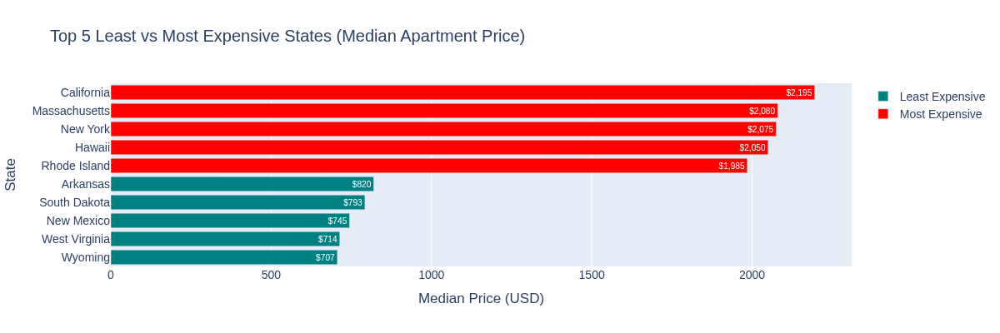

In [15]:
# Save the figure as an image & Display in report
# Note: This is done so the plotly graph is displayed in the exported pdf
# ----------------------------------------------------------------------
pio.write_image(fig,"./images/top5_least_vs_most_expensive.png",width=1200, height=400)
Image("./images/top5_least_vs_most_expensive.png")

In [16]:
# Get visualization of top 10 states with the most listings
top_states = df["state"].value_counts().head(10).reset_index()
top_states.columns = ['state', 'count']  # Rename columns for clarity
top_states["state_name"] = top_states["state"].map(state_names)
fig = px.bar(
    top_states,
    x='count',
    y='state_name',
    orientation='h',
    title='Top 10 States with the Most Listings'
)
fig.update_layout(
    xaxis_title='Number Of Listings',
    yaxis_title='State Name',
    yaxis=dict(categoryorder='total ascending')
)
fig.show()

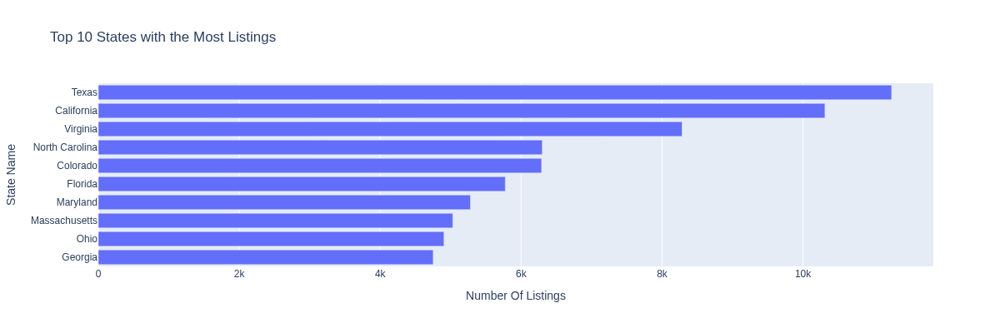

In [17]:
# Save the figure as an image & Display in report
# Note: This is done so the plotly graph is displayed in the exported pdf
# ----------------------------------------------------------------------
pio.write_image(fig,"./images/top10_states_with_the_most_listings.png",width=1200, height=400)
Image("./images/top10_states_with_the_most_listings.png")

In [18]:
# Analysing how prices change over time per state (time intervals are in months)
df["time_readable"] = pd.to_datetime(df["time"], unit='s')
df["month"] = df["time_readable"].dt.to_period("M").astype(str)
top_states = df['state'].value_counts().head(10).index

# Group by state and month, get median price and count
plot_df = (
    df[df['state'].isin(top_states)]
    .groupby(['state', 'month'])
    .agg(price=('price', 'median'), count=('price', 'size'))
    .reset_index()
)

fig = px.line(
    plot_df,
    x='month',
    y='price',
    color='state',
    markers=True,
    title='Median Apartment Price by Month (Top 10 States)',
    labels={'month': 'Month', 'price': 'Median Price', 'state': 'State'},
    custom_data=['count']  # Set custom data here for hovertemplate
)

# Add sample count as hover info
fig.update_traces(
    hovertemplate=''
    '<b>%{x}</b>'
    '<br>Median Price: $%{y:,.0f}'
    '<br>Samples: %{customdata[0]}'
)

fig.update_layout(xaxis_tickangle=-45)
fig.show()
# Investigating why california rose so much in this month
print(f"Sudden Spike in November for CA:")
print(
    df.loc[
        (df["month"] == "2019-11") &
        (df["state"] == "CA")
    ]["price"]
)


df.drop(["time_readable","month"],axis=1,inplace=True)
# Conclusion:
# State prices are mostly stable throughout the year in which this data was recorded

Sudden Spike in November for CA:
7123    9,450.00
51779     850.00
Name: price, dtype: float64


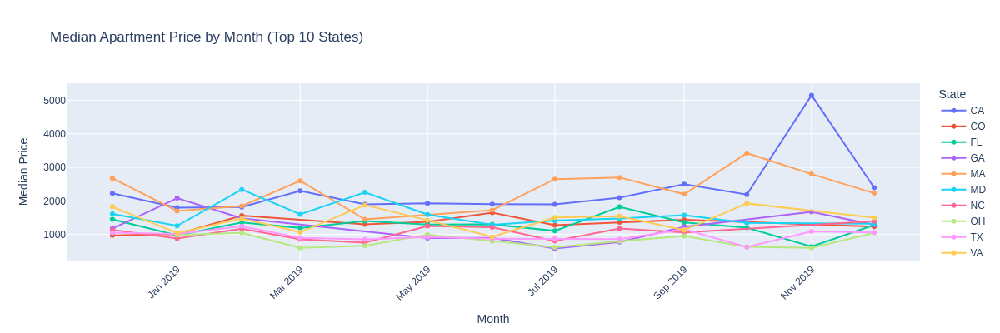

In [19]:
# Save the figure as an image & Display in report
# Note: This is done so the plotly graph is displayed in the exported pdf
# ----------------------------------------------------------------------
pio.write_image(fig,"./images/median_price_by_month_top_10_states.png",width=1200, height=400)
Image("./images/median_price_by_month_top_10_states.png")

# (b) Prepare the data for machine learning algorithms

**Data preprocessing pipeline implemented using Spark MLlib to transform raw apartment rental data into ML-ready format.**

## 🎯 **Data Cleaning & Quality Issues**
- **Removed low-variance features**: Dropped columns with >90% single values (currency, category, fee, etc.)
- **Handled missing data**: Addressed 92% missing addresses and 60% missing pet policies  
- **Eliminated duplicates**: Cleaned duplicate IDs and redundant listings
- **Outlier treatment**: Applied IQR-based filtering to remove extreme values in price, bedrooms, bathrooms, and square footage

## 🔧 **Feature Engineering**
- **Geographic transformation**: Converted lat/lon coordinates into regional categories (northwest, northeast, southwest, southeast, central)
- **High cardinality reduction**: 
  - Amenities: Applied Pareto analysis (90% coverage) + one-hot encoding for top amenities
  - Cities: Reduced 2,979 cities to top 80% coverage + "other" category
- **New features**: Created `sqft_per_room` and interaction terms using RFormula
- **Text processing**: Excluded free-text fields (title, body) from current implementation

## ⚙️ **ML Pipeline Preparation**
- **Feature vectorization**: Used RFormula to create feature vectors with interaction terms:
  - `bedrooms:bathrooms`, `bedrooms:square_feet`, `bathrooms:square_feet`
- **Data scaling**: Applied StandardScaler for linear models while preserving tree-based model compatibility
- **Train/test split**: 80/20 split with both scaled and unscaled versions
- **Data persistence**: Saved preprocessed data as Parquet format for efficient reuse

In [20]:
# Initialize spark
from pyspark.ml.feature import RFormula
from pyspark.sql import SparkSession
import psutil

total_memory = psutil.virtual_memory().total // (1024**3)  # GB
cpu_cores = psutil.cpu_count()
print(f"Specs: {total_memory}GB RAM, {cpu_cores} CPU cores")

spark = SparkSession.builder \
    .appName("CSCI316-Task2-Optimized") \
    .config("spark.driver.memory", f"{min(total_memory-4, 20)}g") \
    .config("spark.driver.maxResultSize", "4g") \
    .config("spark.executor.memory", f"{min(total_memory-6, 16)}g") \
    .config("spark.executor.cores", str(min(cpu_cores-2, 6))) \
    .config("spark.default.parallelism", str(cpu_cores * 2)) \
    .config("spark.sql.adaptive.enabled", "true") \
    .config("spark.sql.adaptive.coalescePartitions.enabled", "true") \
    .config("spark.serializer", "org.apache.spark.serializer.KryoSerializer") \
    .config('spark.kryoserializer.buffer.max', '512m') \
    .getOrCreate()
# Check Spark UI URL and enable logging
print(f"Spark UI URL: {spark.sparkContext.uiWebUrl}")
print(f"Spark App ID: {spark.sparkContext.applicationId}")
print(f"Spark Master: {spark.sparkContext.master}")

# Enable more verbose logging for better progress tracking
spark.sparkContext.setLogLevel("INFO")


Specs: 15GB RAM, 16 CPU cores
Spark UI URL: http://8cb6483f777d:4040
Spark App ID: local-1755430309770
Spark Master: local[*]


In [21]:
# Load the data
data = spark.createDataFrame(df)
data.printSchema()

root
 |-- id: long (nullable = true)
 |-- category: string (nullable = true)
 |-- title: string (nullable = true)
 |-- body: string (nullable = true)
 |-- amenities: string (nullable = true)
 |-- bathrooms: double (nullable = true)
 |-- bedrooms: double (nullable = true)
 |-- currency: string (nullable = true)
 |-- fee: string (nullable = true)
 |-- has_photo: string (nullable = true)
 |-- pets_allowed: string (nullable = true)
 |-- price: double (nullable = true)
 |-- price_display: string (nullable = true)
 |-- price_type: string (nullable = true)
 |-- square_feet: long (nullable = true)
 |-- address: string (nullable = true)
 |-- cityname: string (nullable = true)
 |-- state: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- source: string (nullable = true)
 |-- time: long (nullable = true)



In [22]:
# Drop redundant columns, dominated/uninformative features
# --------------------------------------------------------
columns_to_drop = []

# Same information as price
if "price_display" in data.columns:
    columns_to_drop.append("price_display")

# All rows are in USD
if "currency" in data.columns:
    columns_to_drop.append("currency")

# Category, 99.9% are housing/rent/apartment, Ignore other values then just drop this column
if "category" in data.columns:
    data = data.filter(data["category"] == "housing/rent/apartment")
    columns_to_drop.append("category")

# Similarly to category, fee is 99.8% No, Ignore other values then just drop this column
if "fee" in data.columns:
    data = data.filter(data["fee"] == "No")
    columns_to_drop.append("fee")

# 91.4% of all sources are RentDigs.com, we can just drop this column then check if there are duplicate listings later on
if "source" in data.columns:
    columns_to_drop.append("source")

# Price_type only has 4 values that is not monthly, Ignore other values, drop the column
if "price_type" in data.columns:
    data = data.filter(data["price_type"] == "Monthly")
    columns_to_drop.append("price_type")

# time just shows when the listing was made, all the listings were recorded in the span of ~1 year
if "time" in data.columns:
    columns_to_drop.append("time")

# has_photo just shows photo availability, not informative for regression task
if "has_photo" in data.columns:
    columns_to_drop.append("has_photo")

# Drop all columns at once
data = data.drop(*columns_to_drop)


In [23]:
# Handle features with missing values
# --------------------------------------------------------
from pyspark.sql.functions import explode, split, col, when

columns_to_drop = []
# Address has 92% missing values,
# The address itself is not very informative even if provided so can safely drop
if "address" in data.columns:
    columns_to_drop.append("address")

# Pets_allowed has 60.7% missing values, means most apartments do not allow pets
# We one hot encode this
data = data.fillna({"pets_allowed": "None"})
data = data.replace("NaN","None",subset=["pets_allowed"])
pets_allowed_list = (
    data.select(explode(split(data.pets_allowed, ",")).alias("pet"))
    .distinct()
    .rdd.flatMap(lambda x: x)
    .collect()
)
for pet in pets_allowed_list:
    if pet == "None":
        continue
    data = data.withColumn(
        f'allows_{pet}',
        when(col('pets_allowed').contains(pet),1).otherwise(0)
    )
columns_to_drop.append("pets_allowed")


# Amenities has 16% missing values, this likely means the absence of amenities, change the null values to instead be "None provided".
# This will be furthere processed later on to handle the high cardinality
data = data.fillna({"amenities": "None provided"})
data = data.replace("","None provided",subset=["amenities"])
data = data.replace("NaN","None provided",subset=["amenities"])



# Other features have less than 1% of values missing we can drop these
data = data.drop(*columns_to_drop)
data = data.na.drop()

# Check if any features still have missing values
pd.set_option('display.float_format', lambda x: f'{x:,.4f}')
check_missing = data.toPandas()
missing_values = (check_missing.isnull().sum())/ (check_missing.shape[0]) * 100
print("features with missing values:", missing_values.loc[missing_values > 0].sort_values(ascending=False))
data.head(1)

features with missing values: Series([], dtype: float64)


[Row(id=5668640009, title='One BR 507 & 509 Esplanade', body='This unit is located at 507 & 509 Esplanade, Redondo Beach, 90277, CAMonthly rental rates range from $2195We have 1 beds units available for rent', amenities='None provided', bathrooms=1.0, bedrooms=1.0, price=2195.0, square_feet=542, cityname='Redondo Beach', state='CA', latitude=33.852, longitude=-118.3759, allows_Dogs=0, allows_Cats=1)]

In [24]:
# Create geographic regions based on latitude and longitude
# --------------------------------------------------------
from pyspark.sql.functions import col, when, percentile_approx
from pyspark.sql import functions as F

# Instead of dropping lat/lon, create regional features
print("Creating geographic regions from latitude and longitude...")

# Calculate geographic boundaries using percentiles
lat_bounds = data.select(
    F.expr("percentile_approx(latitude, 0.33)").alias('lat_33'),
    F.expr("percentile_approx(latitude, 0.67)").alias('lat_67')
).collect()[0]

lon_bounds = data.select(
    F.expr("percentile_approx(longitude, 0.33)").alias('lon_33'),
    F.expr("percentile_approx(longitude, 0.67)").alias('lon_67')
).collect()[0]

lat_33, lat_67 = lat_bounds['lat_33'], lat_bounds['lat_67']
lon_33, lon_67 = lon_bounds['lon_33'], lon_bounds['lon_67']

print(f"Latitude boundaries: {lat_33:.4f}, {lat_67:.4f}")
print(f"Longitude boundaries: {lon_33:.4f}, {lon_67:.4f}")

# Create regions based on geographic quadrants + central zone
data = data.withColumn(
    "resides_in",
    when((col("latitude") >= lat_67) & (col("longitude") <= lon_33), "northwest")
    .when((col("latitude") >= lat_67) & (col("longitude") >= lon_67), "northeast")
    .when((col("latitude") <= lat_33) & (col("longitude") <= lon_33), "southwest")
    .when((col("latitude") <= lat_33) & (col("longitude") >= lon_67), "southeast")
    .otherwise("central")
)

# Show distribution of regions
print("\nRegion distribution:")
data.groupBy("resides_in").count().orderBy("count", ascending=False).show()

# Now drop the original lat/lon columns
data = data.drop(*['latitude','longitude'])

Creating geographic regions from latitude and longitude...
Latitude boundaries: 34.0899, 39.3284
Longitude boundaries: -96.8458, -80.8124

Region distribution:
+----------+-----+
|resides_in|count|
+----------+-----+
|   central|59334|
| southwest|14409|
| northeast|13427|
| northwest|10598|
| southeast| 1252|
+----------+-----+



In [25]:
# Inspect duplicate Ids see if legitimate
# --------------------------------------------------------
duplicate_ids_df = data.toPandas()
duplicate_ids = duplicate_ids_df['id'].value_counts()
duplicate_ids = duplicate_ids[duplicate_ids > 1]
duplicates_different_data = []

# For each id we check if all features are the same value
for i, val in duplicate_ids.items():
    cur = duplicate_ids_df.loc[duplicate_ids_df["id"] == i]
    is_all_same = cur.nunique().eq(1).all()

    # Find columns that have unique values that are not eq(1)
    column_names = []
    if not is_all_same:
        for col,n_unique in cur.nunique().items():
            if n_unique != 1:
                column_names.append((col,n_unique))
        duplicates_different_data.append((i,column_names))
print(f"IDs with different data: ",duplicates_different_data)
# All duplicate ids can be safely dropped.
data = data.dropDuplicates(['id'])

IDs with different data:  []


In [26]:
# Check if there are any duplicate listings based on all remaining features except 'id'
# --------------------------------------------------------
check_duplicate_listings = data.toPandas()
# Find all duplicated rows (excluding 'id')
duplicate_mask = check_duplicate_listings.duplicated(keep=False)
if duplicate_mask.any():
    print(f"Found {duplicate_mask.sum()} duplicate listings based on all features except 'id'.")
else:
    print("No duplicate listings found based on all features except 'id'.")
columns_to_drop = []

# We will ignore the title and body columns in this implementation -> Possible improvements can be made by using NLP to extract features from these columns
if "title" in data.columns:
    # title is a free text field, will exclude this for the current regression task
    columns_to_drop.append("title")

if "body" in data.columns:
    # body is a free text field, will exclude this for the current regression task
    columns_to_drop.append("body")
data= data.drop(*columns_to_drop)

No duplicate listings found based on all features except 'id'.


In [27]:
# High cardinality in amenities
# --------------------------------------------------------
# Amenities has extremely high cardinality as a result of combinatorial explosion (e.g Gym, Pool and Pool, Gym are treated as 2 unique values)
from pyspark.sql.functions import split, explode, when, col, count
from pyspark.sql.types import IntegerType
from pyspark.sql.functions import udf

# Explode the amenities then count them
amenities_exploded = data.select(explode(split(data.amenities, ",")).alias('amenity'))
# Remove "None provided" from the amenities
amenity_counts = (
	amenities_exploded
	.filter(col('amenity') != "None provided")
	.groupBy('amenity')
	.agg(count("*").alias("count"))
	.orderBy('count', ascending=False)
)

# Convert to pandas dataframe
amenities_df = amenity_counts.toPandas()
amenities_df["cumulative_count"] = amenities_df["count"].cumsum()
amenities_df["cumulative_pct"] = amenities_df["cumulative_count"]/amenities_df["count"].sum() * 100
amenities_df["cumulative_pct"] = amenities_df["cumulative_pct"].round(1)

# Get the amenities that account for 90% of all mentions
amenities_90pct = amenities_df.loc[amenities_df["cumulative_pct"] <= 90]
pareto_90_threshold = amenities_90pct["count"].values[-1]  # The minimum count in this group
pareto_90 = len(amenities_90pct)  # Number of amenities

print(f"{pareto_90} amenities out of {amenities_df['amenity'].count()} account for 90% of all mentions")
print(f"Threshold: amenities with >= {pareto_90_threshold} mentions")
print("\nTop amenities that make up 90% of mentions:")
print(amenities_90pct[['amenity', 'count', 'cumulative_pct']])

# Get the list of important amenities
amenity_list = amenities_90pct["amenity"].values.tolist()
# Process the data
for amenity in amenity_list:
    data = data.withColumn(
        f"has_{amenity.lower()}",
        when(col("amenities").contains(amenity), 1).otherwise(0)
    )

# Create a column for "other" amenities (not in amenity_list and not "None provided")
# Prepare amenity_list for comparison (lowercase and stripped)
amenity_set = set([a.strip().lower() for a in amenity_list])

# define a function to handle amenities str
def has_other_amenities(amenities_str):
    if amenities_str == "None provided":
        return 0
    items = [a.strip().lower() for a in amenities_str.split(",")]
    return int(any(a not in amenity_set for a in items))

# declare the udf (user defined function)
has_other_udf = udf(has_other_amenities, IntegerType())

# Apply the udf
data = data.withColumn("has_other", has_other_udf(col("amenities")))
data = data.drop("amenities")

# This results in
# - One hot encoded features for the amenities that account for ~90% of all mentions
# - Rest of the amenities are instead under has_other
# - rows with "None provided" will have all amenity columns as 0 -> implying the absence of amenities
data.head(1)

15 amenities out of 27 account for 90% of all mentions
Threshold: amenities with >= 8707 mentions

Top amenities that make up 90% of mentions:
               amenity  count  cumulative_pct
0              Parking  43569         12.0000
1                 Pool  43359         24.0000
2                  Gym  37144         34.2000
3           Patio/Deck  26413         41.5000
4         Washer Dryer  25842         48.6000
5              Storage  21503         54.5000
6            Clubhouse  19033         59.8000
7           Dishwasher  16480         64.3000
8                   AC  15701         68.6000
9            Fireplace  14855         72.7000
10        Refrigerator  14742         76.8000
11  Cable or Satellite  12457         80.2000
12          Playground  11300         83.4000
13     Internet Access  10992         86.4000
14         Wood Floors   8707         88.8000


[Row(id=5121046702, bathrooms=1.0, bedrooms=2.0, price=910.0, square_feet=900, cityname='Orange Park', state='FL', allows_Dogs=0, allows_Cats=0, resides_in='central', has_parking=0, has_pool=1, has_gym=0, has_patio/deck=0, has_washer dryer=0, has_storage=0, has_clubhouse=0, has_dishwasher=0, has_ac=0, has_fireplace=0, has_refrigerator=0, has_cable or satellite=0, has_playground=0, has_internet access=0, has_wood floors=0, has_other=0)]

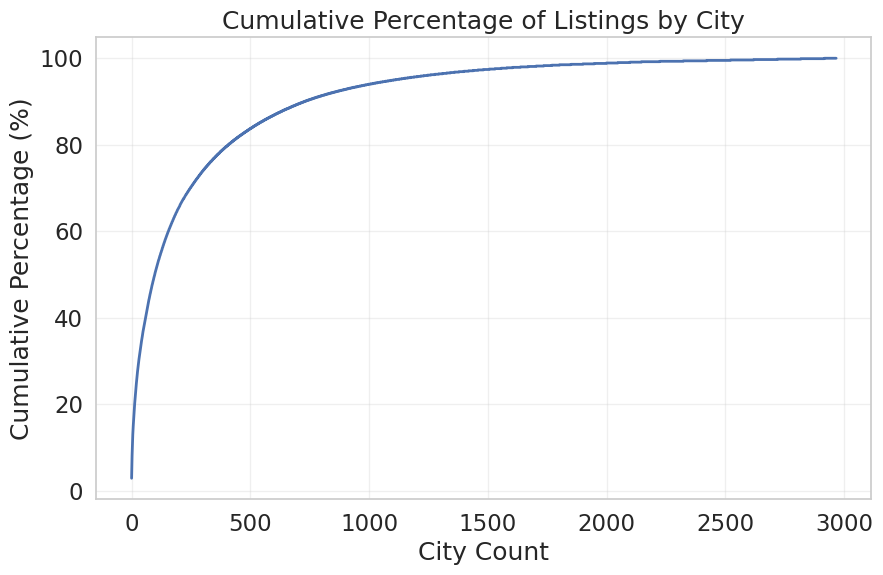

10% coverage requires 4 cities
30% coverage requires 31 cities
50% coverage requires 98 cities
60% coverage requires 156 cities
70% coverage requires 248 cities
80% coverage requires 409 cities
90% coverage requires 731 cities

Get cities that account for 80%, categorize the rest as others


[Row(cityname='other', count=19763),
 Row(cityname='Dallas', count=2852),
 Row(cityname='Denver', count=2745),
 Row(cityname='Los Angeles', count=2397),
 Row(cityname='Las Vegas', count=1844),
 Row(cityname='Arlington', count=1570),
 Row(cityname='Atlanta', count=1503),
 Row(cityname='Charlotte', count=1122),
 Row(cityname='Alexandria', count=914),
 Row(cityname='Richmond', count=912)]

In [28]:
# High cardinality in cityname
# --------------------------------------------------------
# Get state counts
state_counts = data.groupBy('state').count().orderBy('count',ascending=False)

# Create pandas dataframe with cumulative stats
state_df = state_counts.toPandas()
state_df["cumulative_sum"] = state_df["count"].cumsum()
state_df["cumulative_pct"] = state_df["count"].cumsum() / state_df["count"].sum() * 100
state_df["cumulative_pct"] = state_df["cumulative_pct"].round(1)
state_df = state_df.reset_index().rename(columns={'index':'state_count'})


# Get city counts
city_counts = data.groupBy('cityname').count().orderBy('count', ascending=False)

# Create pandas dataframe with cumulative stats
city_counts_df = city_counts.toPandas()
city_counts_df["cumulative_sum"] = city_counts_df["count"].cumsum()
city_counts_df["cumulative_pct"] = city_counts_df["count"].cumsum() / city_counts_df["count"].sum() * 100
city_counts_df["cumulative_pct"] = city_counts_df["cumulative_pct"].round(1)
city_counts_df = city_counts_df.reset_index().rename(columns={'index':'city_count'})

# Plot cumulative percentage for city only
fig, ax1 = plt.subplots(1, 1, figsize=(10, 6))

# City plot
ax1.plot(city_counts_df["city_count"], city_counts_df["cumulative_pct"], 'b-', linewidth=2)
ax1.set_xlabel("City Count")
ax1.set_ylabel("Cumulative Percentage (%)")
ax1.set_title("Cumulative Percentage of Listings by City")
ax1.grid(True, alpha=0.3)
plt.show()

# Apply pareto analysis to reduce cardinality of citynames
city_counts_df = city_counts_df.reset_index().rename(columns={'index':'city_count'})
N = [10,30,50,60,70,80,90]
for n in N:
    print(f"{n}% coverage requires {city_counts_df.loc[city_counts_df['cumulative_pct'] <= n, 'cityname'].count()} cities")

print(f"\nGet cities that account for 80%, categorize the rest as others")
city_list = city_counts_df.loc[city_counts_df["cumulative_pct"]<=80]["cityname"].values.tolist()
data = data.withColumn(
    'cityname',
    when(col('cityname').isin(city_list), col('cityname')).otherwise('other')
)
data.groupBy('cityname').count().orderBy('count',ascending=False).head(10)

In [29]:
# Outliers in price, bedrooms, bathrooms, price, square_feet
# --------------------------------------------------------
# Use IQR to remove outliers
from pyspark.sql.functions import col, stddev, mean
from pyspark.sql import functions as F

outlier_cols = ["bedrooms","bathrooms","price","square_feet"]
og_count = data.count()
print(f"Before outlier removal, Total rows: {og_count}")

for col_name in outlier_cols:
    quantiles = data.select(
        F.expr(f"percentile_approx({col_name},0.25)").alias('Q1'),
        F.expr(f"percentile_approx({col_name},0.75)").alias('Q3'),
    ).collect()[0]

    Q1 = quantiles["Q1"]
    Q3 = quantiles["Q3"]
    IQR = Q3 - Q1

    # Define outlier bounds
    lower_bound = Q1 - 3 * IQR
    upper_bound = Q3 + 3 * IQR

    print(f"{col_name}: Removing values < {lower_bound:.2f} or > {upper_bound:.2f}")

    data = data.filter(
        (col(col_name) >= lower_bound) &
        (col(col_name) <= upper_bound)
        )
new_count = data.count()
print(f"Before outlier removal, Total rows: {new_count}")
print(f"Removed: {og_count - new_count} rows ({((og_count - new_count) /og_count  * 100):.1f}%)")

Before outlier removal, Total rows: 98936
bedrooms: Removing values < -2.00 or > 5.00
bathrooms: Removing values < -2.00 or > 5.00
price: Removing values < -1329.00 or > 4138.00
square_feet: Removing values < -419.00 or > 2255.00
Before outlier removal, Total rows: 97053
Removed: 1883 rows (1.9%)


In [30]:
# New features
# --------------------------------------------------------
data = data.withColumn(
    "sqft_per_room",
    col("square_feet") / (col("bedrooms") + col("bathrooms") + 0.1)
    )

In [31]:
# New feature using RFormula
# --------------------------------------------------------
from pyspark.ml.feature import RFormula
data= data.drop('id')

# bedrooms:bathrooms -> Captures the premium value when both bedrooms and bathrooms are high
# bedrooms:square_feet -> Models the relationship between the number of bedrooms and the size of the apartment
# bathrooms:square_feet -> Models the relationship between the number of bathrooms and the size of the apartment


# Create new feature using RFormula
rform = RFormula(
    formula="""price ~ . +
    bedrooms:bathrooms +
    bedrooms:square_feet +
    bathrooms:square_feet
    """,
    featuresCol="features",
    labelCol="label"
)

# Transform the data
transformed_data = rform.fit(data).transform(data)
# Save transformed data as Parquet
transformed_data.write \
    .mode("overwrite") \
    .option("compression", "snappy") \
    .parquet("./data/transformed_apartment_data.parquet")

print("Transformed data saved as Parquet!")
transformed_data.toPandas().head(5)

Transformed data saved as Parquet!


,bathrooms,bedrooms,price,square_feet,cityname,state,allows_Dogs,allows_Cats,resides_in,has_parking,...,has_fireplace,has_refrigerator,has_cable or satellite,has_playground,has_internet access,has_wood floors,has_other,sqft_per_room,features,label
0,1.0000,2.0000,910.0000,900,other,FL,0,0,central,0,...,0,0,0,0,0,0,0,290.3226,"(1.0, 2.0, 900.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0...",910.0000
1,1.0000,2.0000,999.0000,588,Atlanta,GA,1,1,central,1,...,0,1,1,1,0,0,1,189.6774,"(1.0, 2.0, 588.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",999.0000
2,1.0000,1.0000,935.0000,700,other,FL,0,0,central,0,...,0,0,0,0,0,0,0,333.3333,"(1.0, 1.0, 700.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0...",935.0000
3,2.0000,2.0000,"1,163.0000",1155,other,FL,0,0,central,0,...,1,0,0,0,0,0,0,281.7073,"(2.0, 2.0, 1155.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0....","1,163.0000"
4,2.0000,3.0000,"2,493.0000",1193,Atlanta,GA,1,1,central,1,...,0,0,0,0,0,0,0,233.9216,"(2.0, 3.0, 1193.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","2,493.0000"


# (c) & (d) Select and Train model

Pipeline
- Load the data
- Split the data into train_data and test_data
- Define a scaler and fit scaler to train_data
- Use scaler to transform both train_data and test_data to create scaled_train_data and scaled_test_data

We will have a non-scaled and scaled train_data and test_data as some of the models do not require scaled data whereas, others perform better when fitted to scaled data.


In [32]:
from pyspark.ml.feature import StandardScaler, VectorAssembler
from pyspark.ml import Pipeline
import os

# Load data
loaded_data = spark.read.parquet("./data/transformed_apartment_data.parquet")
# Split data
train_data, test_data = loaded_data.randomSplit([0.8, 0.2], seed=42)
print(f"Train data: {train_data.count()} rows, Test data: {test_data.count()} rows")

# Scale the entire RFormula 'features' vector for linear models
# Use withMean=False to preserve sparse structure of one-hot encoded features
scaler = StandardScaler(
    inputCol="features",          # RFormula output
    outputCol="scaled_features",
    withStd=True,                 # Scale standard deviation
    withMean=False               # DON'T center around mean (preserves one-hot encoding)
)
scaler_model = scaler.fit(train_data)
scaled_train_data = scaler_model.transform(train_data)
scaled_test_data = scaler_model.transform(test_data)
# Save to load later
scaler_model.write().overwrite().save(os.path.join("./models/scaler"))

# Cache training data in memory for faster access
train_data = train_data.cache()
test_data = test_data.cache()
scaled_train_data = scaled_train_data.cache()
scaled_test_data = scaled_test_data.cache()

print("Data cached for faster repeated access")

Train data: 77838 rows, Test data: 19215 rows
Data cached for faster repeated access


## Model 1: Gradient Boosted Trees (GBT)

### 🔧 Hyperparameter Fine-tuning

| Parameter           | Options           | Description                                                                 |
|---------------------|-------------------|-----------------------------------------------------------------------------|
| **maxIter**         | 150, 200     | Number of boosting iterations (trees) in the ensemble                       |
| **maxDepth**        | 6, 8        | Maximum depth of each individual tree                                       |
| **stepSize**        | 0.1, 0.15   | Learning rate; how much each tree contributes to the final prediction       |

#### Parameter Details

- **maxIter**: Number of boosting iterations (trees) in the ensemble.  
  *Higher values increase model complexity and training time, but may improve accuracy.*

- **maxDepth**: Maximum depth of each individual tree.  
  *Deeper trees can capture more complex patterns but risk overfitting.*

- **stepSize**: Learning rate, controlling how much each tree contributes to the final prediction.  
  *Lower values make learning more gradual and stable, but require more iterations.*

- **subsamplingRate**: Fraction of training data randomly sampled for each tree.  
  *Lower values introduce more randomness, which can help prevent overfitting and improve generalization.*

> **Note:** This grid search will train 8 parameter combinations. With 3-fold cross-validation, a total of 24 models will be trained. 

---

### 🔁 3-Fold Cross Validation

- The dataset is split into 3 equal folds.
- For each run, the model is trained on 2 folds and tested on the remaining fold.
- This process repeats 3 times, each time with a different fold as the test set.
- The final performance metric is the average of the 3 test results.

In [33]:
from pyspark.ml.regression import GBTRegressor, GBTRegressionModel
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator, CrossValidatorModel

# GBT with hyperparameter tuning
gbt = GBTRegressor(
    featuresCol="features",
    labelCol="label",
    predictionCol="prediction",
    subsamplingRate=0.9,  # Use 90% of data for each tree
    seed=42
)

# Hyperparameter grid
param_grid = ParamGridBuilder() \
    .addGrid(gbt.maxIter, [150, 200]) \
    .addGrid(gbt.maxDepth, [6, 8]) \
    .addGrid(gbt.stepSize, [0.1, 0.15]) \
    .build()

# Cross validation
cv = CrossValidator(
    estimator=gbt,
    estimatorParamMaps=param_grid,
    evaluator=RegressionEvaluator(labelCol="label", predictionCol="prediction", metricName="rmse"),
    numFolds=3,
    parallelism=min(cpu_cores-1, 6),
    seed=42
)

model_path = "./models/gbt_regressor"
retrain=False
if not os.path.exists(os.path.join(model_path,"gbt_best_model")) or retrain:
    print("Training GBT with Cross Validation...")
    cv_model = cv.fit(train_data)
    gbt_best_model = cv_model.bestModel
    print(f"Best parameters found: ")
else:
    print("Loading best pre-trained GBT model...")
    gbt_best_model = GBTRegressionModel.load(os.path.join(model_path,"gbt_best_model"))
    print(f"Loaded model with paremeters: ")


print(f"maxIter: {gbt_best_model.getMaxIter()}")
print(f"maxDepth: {gbt_best_model.getMaxDepth()}")
print(f"stepSize: {gbt_best_model.getStepSize()}")
print(f"subsamplingRate: {gbt_best_model.getSubsamplingRate()}")

gbt_train_predictions = gbt_best_model.transform(train_data)
gbt_test_predictions = gbt_best_model.transform(test_data)

# Evaluate the model
evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction")

# Calculate train metrics
train_rmse = evaluator.evaluate(gbt_train_predictions, {evaluator.metricName: "rmse"})
train_mae = evaluator.evaluate(gbt_train_predictions, {evaluator.metricName: "mae"})
train_r2 = evaluator.evaluate(gbt_train_predictions, {evaluator.metricName: "r2"})
# Calculate test metrics
test_rmse = evaluator.evaluate(gbt_test_predictions, {evaluator.metricName: "rmse"})
test_mae = evaluator.evaluate(gbt_test_predictions, {evaluator.metricName: "mae"})
test_r2 = evaluator.evaluate(gbt_test_predictions, {evaluator.metricName: "r2"})

# Show metrics
performance_data = {
    'Metric': ['RMSE', 'MAE', 'R²', "Sample Size"],
    'Train': [f'{train_rmse:.2f}', f'{train_mae:.2f}', f'{train_r2:.4f}',f'{train_data.count()}'],
    'Test': [f'{test_rmse:.2f}', f'{test_mae:.2f}', f'{test_r2:.4f}',f'{test_data.count()}']
}
performance_df_gbt = pd.DataFrame(performance_data)
print(f"\nGBT Model Performance (Best Parameters):")
print(performance_df_gbt)

# Save the model if doesnt exist
if not os.path.exists(os.path.join(model_path,"gbt_best_model")) or retrain:
    print(f"Saving the best GBT model to {os.path.join(model_path,'gbt_best_model')}")
    gbt_best_model.write().overwrite().save(os.path.join(model_path,"gbt_best_model"))
if not os.path.exists(os.path.join(model_path,"cv_model")) or retrain:
    print(f"Saving the CrossValidator model to {os.path.join(model_path,'cv_model')}")
    cv_model.write().overwrite().save(os.path.join(model_path,"cv_model"))

Loading best pre-trained GBT model...
Loaded model with paremeters: 
maxIter: 200
maxDepth: 8
stepSize: 0.15
subsamplingRate: 0.9

GBT Model Performance (Best Parameters):
        Metric   Train    Test
0         RMSE  235.85  298.77
1          MAE  161.03  199.38
2           R²  0.8617  0.7829
3  Sample Size   77838   19215


## Model 2: Linear Regression

### 🔧 Hyperparameter Fine-tuning

| Parameter           | Options              | Description                                                                 |
|---------------------|----------------------|-----------------------------------------------------------------------------|
| **regParam**        | 0.01, 0.1            | L2 regularization parameter (Ridge penalty)                                |
| **elasticNetParam** | 0.5, 1.0             | Elastic net mixing parameter (0=L2, 1=L1, 0.5=balanced)                  |
| **maxIter**         | 100, 200             | Maximum number of iterations for optimization                               |

#### Parameter Details

- **regParam**: L2 regularization parameter to prevent overfitting.  
  *Higher values add more penalty to large coefficients, reducing model complexity.*

- **elasticNetParam**: Controls the balance between L1 (Lasso) and L2 (Ridge) regularization.  
  *0.5 = balanced elastic net, 1.0 = pure Lasso regression (L1 only).*

- **maxIter**: Maximum iterations for the optimization algorithm.  
  *Higher values allow more time for convergence but increase training time.*

> **Note:** Linear regression benefits greatly from feature scaling. We use the scaled features for optimal performance.

---

### 🔁 3-Fold Cross Validation

- Uses scaled features for better convergence and performance
- Tests different regularization strategies to prevent overfitting
- Evaluates on RMSE metric to select the best hyperparameter combination
- This grid search will train 8 parameter combinations (2×2×2) with 3-fold CV = 24 models total

In [34]:
from pyspark.ml.regression import LinearRegression, LinearRegressionModel
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator, CrossValidatorModel

# Define model
lr = LinearRegression(
    featuresCol = "scaled_features",
    labelCol="label",
    predictionCol="prediction"
)

param_grid = ParamGridBuilder() \
    .addGrid(lr.regParam, [0.01, 0.05 ,0.1]) \
    .addGrid(lr.elasticNetParam,[0.1,0.5,1.0])\
    .addGrid(lr.maxIter, [100,200,500]) \
    .build()

# Cross validation
cv = CrossValidator(
    estimator=lr,
    estimatorParamMaps = param_grid,
    evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction", metricName="rmse"),
    numFolds =3,
    parallelism=min(cpu_cores-1, 6),
    seed = 24
)

model_path = "./models/linear_regressor"
retrain=False
if not os.path.exists(os.path.join(model_path,"lr_best_model")) or retrain:
    print("Training Linear Regression with Cross Validation...")
    cv_model = cv.fit(scaled_train_data)
    lr_best_model = cv_model.bestModel
    print(f"Best parameters found: ")
else:
    print("Loading best pre-trained LR model ...")
    lr_best_model = LinearRegressionModel.load(os.path.join(model_path,"lr_best_model"))

if os.path.exists(os.path.join(model_path,"cv_model")):
    print("Loading CV model...")
    cv_model = CrossValidatorModel.load(os.path.join(model_path,"cv_model"))
    print("Loaded CV model.")

print(f"regParam (L2 penalty): {lr_best_model.getRegParam()}")
print(f"elasticNetParam (L1/L2 mix): {lr_best_model.getElasticNetParam()}")
print(f"maxIter: {lr_best_model.getMaxIter()}")

lr_train_predictions = lr_best_model.transform(scaled_train_data)
lr_test_predictions = lr_best_model.transform(scaled_test_data)

# Evaluate the model
evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction")

# Calculate train metrics
train_rmse = evaluator.evaluate(lr_train_predictions, {evaluator.metricName: "rmse"})
train_mae = evaluator.evaluate(lr_train_predictions, {evaluator.metricName: "mae"})
train_r2 = evaluator.evaluate(lr_train_predictions, {evaluator.metricName: "r2"})
# Calculate test metrics
test_rmse = evaluator.evaluate(lr_test_predictions, {evaluator.metricName: "rmse"})
test_mae = evaluator.evaluate(lr_test_predictions, {evaluator.metricName: "mae"})
test_r2 = evaluator.evaluate(lr_test_predictions, {evaluator.metricName: "r2"})

# Show metrics
performance_data = {
    'Metric': ['RMSE', 'MAE', 'R²', "Sample Size"],
    'Train': [f'{train_rmse:.2f}', f'{train_mae:.2f}', f'{train_r2:.4f}',f'{train_data.count()}'],
    'Test': [f'{test_rmse:.2f}', f'{test_mae:.2f}', f'{test_r2:.4f}',f'{test_data.count()}']
}
performance_df_lr = pd.DataFrame(performance_data)
print(f"\nLR Model Performance (Best Parameters):")
print(performance_df_lr)

# Save the model if doesnt exist
if not os.path.exists(os.path.join(model_path,"lr_best_model")) or retrain:
    print(f"Saving the best lr model to {os.path.join(model_path,'lr_best_model')}")
    lr_best_model.write().overwrite().save(os.path.join(model_path,"lr_best_model"))
if not os.path.exists(os.path.join(model_path,"cv_model")) or retrain:
    print(f"Saving the CrossValidator model to {os.path.join(model_path,'cv_model')}")
    cv_model.write().overwrite().save(os.path.join(model_path,"cv_model"))

Loading best pre-trained LR model ...
Loading CV model...
Loaded CV model.
regParam (L2 penalty): 0.01
elasticNetParam (L1/L2 mix): 0.1
maxIter: 500

LR Model Performance (Best Parameters):
        Metric   Train    Test
0         RMSE  342.14  350.19
1          MAE  242.84  247.96
2           R²  0.7090  0.7017
3  Sample Size   77838   19215


## Model 3: Random Forest Regression

### 🔧 Hyperparameter Fine-tuning

| Parameter               | Options              | Description                                                                 |
|-------------------------|----------------------|-----------------------------------------------------------------------------|
| **numTrees**           | 100,150                  | Number of trees in the random forest ensemble                              |
| **maxDepth**           | 10, 16               | Maximum depth of each individual tree                                      |
| **featureSubsetStrategy** | "auto"            | Number of features to consider at each split (auto = sqrt(total features)) |

#### Parameter Details

- **numTrees**: Number of trees in the random forest ensemble.  
  *More trees generally improve performance but increase computational cost and training time.*

- **maxDepth**: Maximum depth allowed for each individual tree in the forest.  
  *Deeper trees can capture more complex patterns but may lead to overfitting.*

- **featureSubsetStrategy**: Strategy for selecting features at each split.  
  *"auto" uses sqrt(total_features) which provides good balance between performance and randomness.*

- **subsamplingRate**: Fraction of training data used for each tree (set to 0.7).  
  *Introduces randomness to improve generalization and reduce overfitting.*

- **minInstancesPerNode**: Minimum instances per leaf node (uses default value).  
  *Prevents overfitting by ensuring meaningful sample sizes at leaf nodes.*

> **Note:** Random Forest is an ensemble method that combines multiple decision trees. It's particularly effective at handling non-linear relationships and feature interactions without requiring feature scaling.

---

### 🔁 3-Fold Cross Validation

- Uses original features (not scaled) as Random Forest handles different feature scales naturally
- Tests different tree depth configurations to find optimal complexity
- Evaluates on RMSE metric to select the best hyperparameter combination
- This grid search will train 4 parameter combinations (2x2) with 3-fold CV = 12 models total

In [35]:
from pyspark.ml.regression import RandomForestRegressor, RandomForestRegressionModel
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator, CrossValidatorModel

# Define model
rf = RandomForestRegressor(
    featuresCol="features",
    labelCol="label",
    predictionCol="prediction",
    featureSubsetStrategy="auto",
    seed=42,
    subsamplingRate=0.7
)

# Build hyperparameter grid
param_grid = ParamGridBuilder() \
    .addGrid(rf.maxDepth, [10,16]) \
    .addGrid(rf.numTrees, [100,150]) \
    .build()

# cross validation
cv = CrossValidator(
    estimator=rf,
    estimatorParamMaps=param_grid,
    evaluator=RegressionEvaluator(labelCol="label", predictionCol="prediction", metricName="rmse"),
    numFolds=3,
    parallelism=min(cpu_cores-1, 6),
    seed=42
)

model_path = "./models/random_forest_regressor"
retrain=False
if not os.path.exists(os.path.join(model_path,"rf_best_model")) or retrain:
    print("Training RF with Cross Validation...")
    cv_model = cv.fit(train_data)
    rf_best_model = cv_model.bestModel
    print(f"Best parameters found: ")
else:
    print("Loading best pre-trained FM model ...")
    rf_best_model = RandomForestRegressionModel.load(os.path.join(model_path,"rf_best_model"))
    print(f"Loaded model with paremeters: ")

print(f"numTrees: {rf_best_model.getNumTrees}")
print(f"maxDepth: {rf_best_model.getMaxDepth()}")
print(f"featureSubsetStrategy: {rf_best_model.getFeatureSubsetStrategy()}")
print(f"minInstancesPerNode: {rf_best_model.getMinInstancesPerNode()}")
print(f"subsamplingRate: {rf_best_model.getSubsamplingRate()}")
rf_train_predictions = rf_best_model.transform(train_data)
rf_test_predictions = rf_best_model.transform(test_data)

# Evaluate the model
evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction")

# Calculate train metrics
train_rmse = evaluator.evaluate(rf_train_predictions, {evaluator.metricName: "rmse"})
train_mae = evaluator.evaluate(rf_train_predictions, {evaluator.metricName: "mae"})
train_r2 = evaluator.evaluate(rf_train_predictions, {evaluator.metricName: "r2"})

# Calculate test metrics
test_rmse = evaluator.evaluate(rf_test_predictions, {evaluator.metricName: "rmse"})
test_mae = evaluator.evaluate(rf_test_predictions, {evaluator.metricName: "mae"})
test_r2 = evaluator.evaluate(rf_test_predictions, {evaluator.metricName: "r2"})

# Show metrics
performance_data = {
    'Metric': ['RMSE', 'MAE', 'R²', "Sample Size"],
    'Train': [f'{train_rmse:.2f}', f'{train_mae:.2f}', f'{train_r2:.4f}',f'{train_data.count()}'],
    'Test': [f'{test_rmse:.2f}', f'{test_mae:.2f}', f'{test_r2:.4f}',f'{test_data.count()}']
}
performance_df_rf = pd.DataFrame(performance_data)
print(f"\nRF Model Performance (Best Parameters):")
print(performance_df_rf)

# Save the model if doesnt exist
if not os.path.exists(os.path.join(model_path,"rf_best_model")) or retrain:
    print(f"Saving the best RF model to {os.path.join(model_path,'rf_best_model')}")
    rf_best_model.write().overwrite().save(os.path.join(model_path,"rf_best_model"))
if not os.path.exists(os.path.join(model_path,"cv_model")) or retrain:
    print(f"Saving the CrossValidator model to {os.path.join(model_path,'cv_model')}")
    cv_model.write().overwrite().save(os.path.join(model_path,"cv_model"))

Loading best pre-trained FM model ...
Loaded model with paremeters: 
numTrees: 150
maxDepth: 16
featureSubsetStrategy: auto
minInstancesPerNode: 1
subsamplingRate: 0.7

RF Model Performance (Best Parameters):
        Metric   Train    Test
0         RMSE  285.13  327.83
1          MAE  208.38  232.72
2           R²  0.7979  0.7386
3  Sample Size   77838   19215


# (e) Evaluate the outcomes

In [36]:
performance_dfs = [performance_df_rf, performance_df_gbt, performance_df_lr]
model_names = ["Random Forest", "Gradient Boosted Trees", "Linear Regression"]
eval_df = pd.DataFrame({
    'Model': model_names,
    'RMSE': [p['Test'][0] for p in performance_dfs],
    'MAE': [p['Test'][1] for p in performance_dfs],
    'R²': [p['Test'][2] for p in performance_dfs],
    'Sample Size': [p['Test'][3] for p in performance_dfs]
}).sort_values(by="R²",ascending=False)
print("\nModel Evaluation Summary:")
print(eval_df)



Model Evaluation Summary:
                    Model    RMSE     MAE      R² Sample Size
1  Gradient Boosted Trees  298.77  199.38  0.7829       19215
0           Random Forest  327.83  232.72  0.7386       19215
2       Linear Regression  350.19  247.96  0.7017       19215


## Evaluation
- Gradient Boosted Trees performed the best overall with the highest R² score of 0.7829 with the lowest MAE and RMSE
- Random Forest performed well but not as well as Gradient Boosted Trees
- Linear Regression performed the worst compared to the other two models

## Comparison of models

### Training Time 
**Linear Regression**: Despite the fact that the grid search space for the linear regression was the largest compared to the three models, it still was the easiest and fastest to train. This is likely because it is the simplest model out of the three and assumes linear relationships. It however, performed the worst as it is unable to capture non-linear relationships in the apartment rental data.  

**Random Forest**: Random Forest performed better than the linear regressor as it is able to capture non-linear relationships and feature interactions through its ensemble of decision trees. However, it required more computational resources and training time due to building multiple trees (100-150 trees in our hyperparameter grid). The model showed good generalization capabilities but was outperformed by GBT.  

**Gradient Boosted Trees**: GBT achieved the best performance but required the longest training time among all models. This is because it builds trees sequentially, with each tree learning from the errors of previous trees. The boosting process is computationally intensive but results in superior predictive accuracy. The model effectively captured complex patterns in the apartment rental data.  

### Model Characteristics

**Feature Scaling Requirements**:
- Linear Regression required scaled features for optimal performance
- Tree-based models (RF and GBT) worked directly with original features without scaling

**Overfitting Resistance**:
- Linear Regression: Regularization (L1/L2) helped prevent overfitting
- Random Forest: Bootstrap sampling and feature randomness provided natural overfitting protection  
- GBT: Required careful tuning of learning rate and tree depth to avoid overfitting

**Interpretability**:
- Linear Regression: Most interpretable with clear coefficient meanings
- Random Forest: Moderate interpretability through feature importance
- GBT: Least interpretable due to complex sequential tree interactions

### Why Ensemble Methods Outperformed Linear Regression

The apartment rental dataset contains complex, non-linear relationships between features (e.g., location, amenities, property size) that Linear Regression cannot capture due to its linear assumption. Ensemble methods like Random Forest and GBT excel at:

1. **Capturing Non-linear Patterns**: Tree-based models naturally handle non-linear relationships
2. **Feature Interactions**: Automatically detect interactions between features (e.g., bedrooms × bathrooms)
3. **Handling Mixed Data Types**: Effectively process both categorical and numerical features
4. **Robustness to Outliers**: Tree splits are less sensitive to extreme values

The sequential learning approach in GBT, where each tree corrects previous errors, made it particularly effective for this regression task, achieving the highest R² score of 0.7829.

In [37]:
# Export notebook to PDF
!jupyter nbconvert --to pdf --output-dir="./deliverables/" --output "leap-csci316-task2" Leap_Assignment2_Task2.ipynb

[NbConvertApp] Converting notebook Leap_Assignment2_Task2.ipynb to pdf
/opt/conda/share/jupyter/nbconvert/templates/latex/display_priority.j2:32: UserWarning: Your element with mimetype(s) dict_keys(['application/vnd.plotly.v1+json']) is not able to be represented.
  ((*- endblock -*))
[NbConvertApp] Support files will be in leap-csci316-task2_files/
[NbConvertApp] Making directory ./leap-csci316-task2_files
[NbConvertApp] Writing 224107 bytes to notebook.tex
[NbConvertApp] Building PDF
[NbConvertApp] Running xelatex 3 times: ['xelatex', 'notebook.tex', '-quiet']
[NbConvertApp] Running bibtex 1 time: ['bibtex', 'notebook']
[NbConvertApp] WARNING | bibtex had problems, most likely because there were no citations
[NbConvertApp] PDF successfully created
[NbConvertApp] Writing 1303029 bytes to deliverables/leap-csci316-task2.pdf
